# Customer Segmentation

Datos tomados de [Customer Segmentation](https://www.kaggle.com/datasets/alifarahmandfar/customer-segmentation) en Kaggle.

## Business Context

Una empresa de tarjetas de crédito desea segmentar a sus clientes en función de su comportamiento de compra en centros comerciales con el fin de identificar los diferentes tipos de tarjetahabientes y establecer estrategias de marketing personalizadas para cada uno. A continuación, una breve descripción del significado de cada atributo:

| Attribute | Description |
| --- | --- |
| CUST_ID | Credit card holder ID |
| BALANCE | Monthly average balance (based on daily balance averages) |
| BALANCE_FREQUENCY | Ratio of last 12 months with balance. (1: Frequently updated, 0: Not frequently updated) |
| PURCHASES | Total purchase amount spent during last 12 months |
| ONEOFF_PURCHASES | Total amount of one-off purchases |
| INSTALLMENTS_PURCHASES | Total amount of installment purchases |
| CASH_ADVANCE | Total cash-advance amount |
| PURCHASES_FREQUENCY | Frequency of purchases (Percent of months with at least one purchase). (1: Frequently purchased, 0: Not frequently purchased) |
| ONEOFF_PURCHASES_FREQUENCY | Frequency of one-off-purchases. (1: Frequently purchased, 0: Not frequently purchased) |
| PURCHASES_INSTALLMENTS_FREQUENCY | Frequency of installment purchases. (1: Frequently purchased, 0: Not frequently purchased) |
| CASH_ADVANCE_FREQUENCY | Cash-Advance frequency |
| CASH_ADVANCE_TRX | Average amount per cash-advance transaction |
| PURCHASES_TRX | Average amount per purchase transaction |
| CREDIT_LIMIT | Credit limit |
| PAYMENTS | Total payments (Due amount paid by the customer to decrease their statement balance) in the period |
| MINIMUM_PAYMENTS | Total minimum payments due in the period |
| PRC_FULL_PAYMENT | Percentage of months with full payment of the due statement balance |
| TENURE | Number of months as a customer |


La empresa nos ha contratado para llevar adelante este estudio, el cual realizaremos en estas dos primeras semanas del curso. Las tareas para realizar en cada una de ellas son:

1. EDA, data cleaning and preparation.
2. Apply a clustering algorithm for customer segmentation to identify behavior patterns.

In [1]:
# Import relevant libraries
import matplotlib.pyplot as plt

import pandas as pd
from ydata_profiling import ProfileReport

In [17]:
# plt.switch_backend('Qt5Agg')
%matplotlib inline

plt.isinteractive()

True

Let's get started by loading the data in CSV format. Review column names and data types.

In [4]:
raw_data = pd.read_csv("./data/Customer_Data.csv")
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [5]:
raw_data.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,5323.148883,0.250693,26344.072201,38237.442525,3727.113162,15708.239684,0.496536,0.464442,0.821611,0.194502,100,77,16819.480037,21337.027458,39452.958121,0.817907,7
1,C10002,12726.638115,0.791307,37958.519019,5690.742440,18733.810964,38284.354433,0.699457,0.250327,0.654863,1.083902,78,156,15617.570575,8000.183624,63013.748477,0.343119,9
2,C10003,4305.572068,0.176531,28392.953338,36009.470088,2873.383232,14294.185035,0.419764,0.523662,0.899912,0.207049,72,81,15515.586213,27111.360493,NaN,0.829074,6
3,C10004,4740.988511,0.178076,27399.003842,38246.863491,3402.853375,6936.812518,0.439666,0.606597,0.783129,0.228299,78,83,12926.587974,23919.113404,38444.219979,0.883984,7
4,C10005,13820.920640,0.826914,42214.021633,7341.007821,19273.070991,40091.347849,0.821412,0.283579,0.501361,1.106350,88,182,14404.705067,6994.688474,62041.617340,0.383186,10


## Data Processing

Let's check for duplicates and missing values in the data.

In [4]:
raw_data.duplicated().sum()

np.int64(0)

In [5]:
raw_data.isna().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

There are no duplicate entries, but two columns are missing at least one value: ``CREDIT_LIMIT (1)`` and ``MINIMUM_PAYMENTS (313)``. We will handle these later.

### Exploratory Data Analysis (EDA)

In [6]:
raw_data.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,9382.387900,0.459205,30525.873439,22913.665720,11407.851805,22573.474202,0.559810,0.478032,0.623916,0.734946,76.169162,164.981453,14696.640361,19824.347218,44222.977795,0.545414,8.370615
std,5118.113559,0.282998,11041.410943,13573.919086,7087.102996,12594.295895,0.214055,0.221873,0.208207,0.422563,22.260935,71.322003,5537.074673,11069.268177,15468.314241,0.267443,1.756035
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,1006.064965,0.000000,6.000000
25%,4275.036859,0.188490,27106.651600,6698.252490,3736.720194,10944.431111,0.407273,0.250856,0.518231,0.230716,65.000000,97.000000,13487.727313,9329.603116,31572.127683,0.336732,7.000000
50%,12007.718812,0.306650,30934.582274,31011.033488,10832.141085,19465.792260,0.505305,0.533521,0.607608,0.947651,82.000000,176.000000,14942.545347,21367.621276,48780.271754,0.432690,8.000000
75%,13740.565876,0.756061,39825.160798,34495.416423,19127.083036,36150.722564,0.777084,0.649120,0.814929,1.029172,92.000000,216.000000,16269.727124,25219.127375,57761.175985,0.815178,10.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


There are large scale differences among features. Ranges vary from [0-1] to [0-80,000].
    - This needs to be handled as we will use distance-based algorithms whose output degrade when the feature scales vary significantly.

In [7]:
ProfileReport(raw_data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Findings from the profiling report:

**``CUST_ID``**
- It is a unique identifier thus will not add value to our analysis. This column will be dropped in the next section.

**``TENURE``**
- This represents the number of months as a customer. Our data contains only 7 unique values, going from month 6 to month 12.
    - This may reflect a business decision to only analyze this cohort.

**General Observations**
- Most attributes exhibit multimodal distributions. Indicating presence of subgroups with distinct characteristics.
- There are multiple features highly correlated to each other.
    - The Pearson Correlation coefficients and heatmap show mild to strong linear correlation among variables. This suggests:
        - There are interesting patterns in the data.
        - Given the highly cross-correlation among variables, a dimensionality reduction algorithm could be used to extract the most meaningful information, in a lower dimensional space, and without losing much of the variability (information).
- Interaction plots (e.g. Balance vs Purchase) also show clusters (subgroups with different preferences).

In [9]:
data = raw_data.drop(columns="CUST_ID").copy()

### Outliers
Estimate the number of outliers per feature using the Inter Quartile Range (IQR) method.

In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 17 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   BALANCE                           8950 non-null   float64
 1   BALANCE_FREQUENCY                 8950 non-null   float64
 2   PURCHASES                         8950 non-null   float64
 3   ONEOFF_PURCHASES                  8950 non-null   float64
 4   INSTALLMENTS_PURCHASES            8950 non-null   float64
 5   CASH_ADVANCE                      8950 non-null   float64
 6   PURCHASES_FREQUENCY               8950 non-null   float64
 7   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 8   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 9   CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 10  CASH_ADVANCE_TRX                  8950 non-null   int64  
 11  PURCHASES_TRX                     8950 non-null   int64  
 12  CREDIT

In [13]:
q1 = data.quantile(0.25, numeric_only=True)
q3 = data.quantile(0.75, numeric_only=True)

iqr = q3 - q1

outliers = ((data < (q1 - 1.5*iqr)) | (data > (q3 + 1.5*iqr)))
outliers.sum()

BALANCE                                0
BALANCE_FREQUENCY                      0
PURCHASES                            755
ONEOFF_PURCHASES                       0
INSTALLMENTS_PURCHASES                 0
CASH_ADVANCE                           0
PURCHASES_FREQUENCY                    0
ONEOFF_PURCHASES_FREQUENCY             0
PURCHASES_INSTALLMENTS_FREQUENCY      19
CASH_ADVANCE_FREQUENCY                 0
CASH_ADVANCE_TRX                     253
PURCHASES_TRX                          0
CREDIT_LIMIT                        2184
PAYMENTS                               5
MINIMUM_PAYMENTS                       0
PRC_FULL_PAYMENT                       0
TENURE                                 0
dtype: int64

In [14]:
n_outliers = outliers.any(axis=1).sum()
print(f"Total outliers = {n_outliers}")

Total outliers = 2185


Given the large number of outliers determined by the IQR method. I decided not to drop them as these represent roughly one fourth of our data.
Additionally, the IQR considered univariate analysis only, thus these records may actually have valuable information about our customers.

### Data Cleaning & Processing

We will use data imputation to handle missing values.

In [7]:
import joblib
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import RobustScaler

- Only two features are missing values ``CREDIT_LIMIT (1)`` and ``MINIMUM_PAYMENTS (313)``. These variables are numerical, we will impute them using the mean value.

- We will scale the data to similar ranges using the RobustScaler class.

- Finally, let's also prepare our data for the learning algorithms.

In [10]:
imputer = SimpleImputer()
robust_scaler = RobustScaler()

prepared_data = pd.DataFrame(
    robust_scaler.fit_transform(
        imputer.fit_transform(data)
    )
    , columns = data.columns
)

prepared_data

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-0.706201,-0.098590,-0.360931,0.259969,-0.461654,-0.149072,-0.023711,-0.173450,0.721282,-0.943257,0.666667,-0.831933,0.674832,-0.001925,-0.282135,0.805143,-0.333333
1,0.075951,0.853916,0.552261,-0.910895,0.513417,0.746582,0.525005,-0.711071,0.159271,0.170643,-0.148148,-0.168067,0.242748,-0.841274,0.635545,-0.187212,0.333333
2,-0.813705,-0.229255,-0.199837,0.179818,-0.517126,-0.205171,-0.231310,-0.024756,0.985191,-0.927543,-0.370370,-0.798319,0.206085,0.361480,-0.096346,0.828484,-0.666667
3,-0.767705,-0.226533,-0.277987,0.260308,-0.482723,-0.497058,-0.177491,0.183487,0.591581,-0.900929,-0.148148,-0.781513,-0.724653,0.160577,-0.321425,0.943251,-0.333333
4,0.191558,0.916652,0.886852,-0.851527,0.548456,0.818270,0.854783,-0.627579,-0.358096,0.198757,0.222222,0.050420,-0.193274,-0.904554,0.597681,-0.103467,0.666667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,-0.624635,-0.127391,-0.301967,0.176499,-0.478762,-0.307630,-0.095920,0.014954,0.743898,-0.947605,-0.259259,-0.630252,0.963986,0.162798,-0.461736,0.907451,-0.333333
8946,0.071296,0.668420,0.589616,-0.925184,0.525826,0.594259,0.554410,-0.645540,-0.207444,-0.015654,0.481481,-0.050420,-0.901803,-0.880580,0.780150,-0.263540,0.666667
8947,0.470823,-0.207047,-2.094458,0.055535,0.025949,-0.168653,-0.218056,0.533537,0.278979,0.145452,-1.148148,-0.210084,-4.182658,0.099445,0.314142,-0.634237,0.000000
8948,0.372316,-0.333935,-1.471498,0.028238,0.101251,-0.222540,-0.147737,0.682007,0.003806,0.138889,-0.777778,0.016807,-3.161453,0.000118,0.143012,-0.721590,0.000000


### Save the pre-processed data and preprocessors for Use Later

In [25]:
prepared_data.to_csv("./data/prepared_data.csv", index=False)
joblib.dump(imputer, "./obj/imputer.joblib")
joblib.dump(robust_scaler, "./obj/robust_scaler.joblib")

['./obj/robust_scaler.joblib']

## Modeling

We will use K-Means as clustering algorithm

In [11]:
import numpy as np
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import KMeans
# from sklearn_extra.cluster import KMedoids

from sklearn.pipeline import Pipeline

In [21]:
def elbow_plot(X: np.array, k_min: int = 2, k_max: int = 10):
    """
    Generate the elbot plot for KMeans.
    """
    inertias = []
    for i in range(k_min, k_max+1):
        # print("k = ", i)
        model_k = KMeans(n_clusters=i, max_iter=300,
                         n_init=10, random_state=0)

        # Train the model
        model_k.fit(X)

        # Save the inertial value
        inertias.append(model_k.inertia_)

    # Create the plot
    plt.plot(range(k_min, k_max+1), inertias, marker='o')
    plt.xlabel('Number of Clusters')
    plt.ylabel('Inertia')
    plt.grid()
    plt.show()

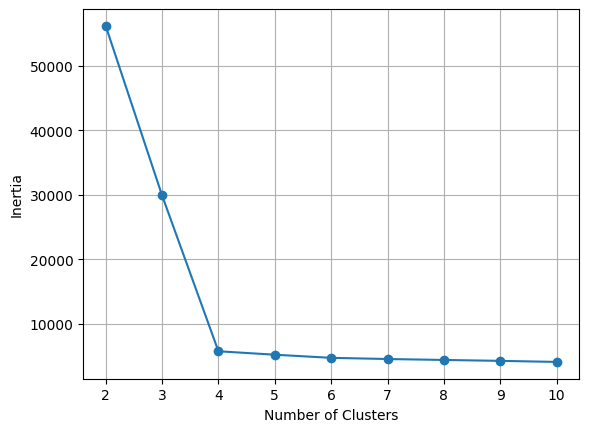

In [22]:
## Elbow method

elbow_plot(prepared_data)

From the Elbow method, k = 4 is the suggested number of clusters as any larger number will not have a significant effect in reducing the sum of squared distances.

In [23]:
def silhouette_plot(X: np.array, k_min: int = 2, k_max: int = 10):
    
    scores = []
    for i in range(k_min, k_max+1):
        model_k = KMeans(n_clusters=i, max_iter=300,
                             n_init=10, random_state=0)
        # Train the model
        model_k.fit(X)
        # Save the silhouette scores
        score = silhouette_score(X, model_k.labels_)
        scores.append(score)
    
    display(pd.DataFrame({'K': range(k_min, k_max+1), 'Score': scores}))
    
    # Create the plot
    plt.plot(range(k_min, k_max+1), scores, marker='o')
    plt.xlabel('Number of Clusters')
    plt.ylabel('Silhouette Score')
    plt.grid()
    plt.show()

,K,Score
0,2,0.464167
1,3,0.610184
2,4,0.749116
3,5,0.539871
4,6,0.340545
5,7,0.258009
6,8,0.234154
7,9,0.210282
8,10,0.147160


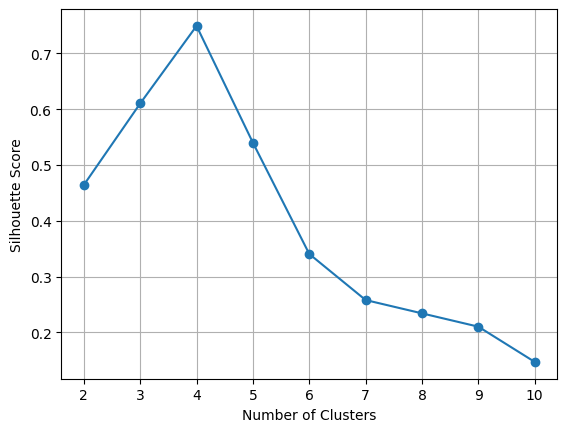

In [24]:
silhouette_plot(prepared_data, 2, 10)

The Silhouette score exhibits a maximum of 0.75 in k = 4. This is in agree with the output of the elbow graph. Thus, let's use 4 clusters to train our model and interpret the results.

## Interpretation

In [30]:
import seaborn as sns

In [25]:
best_model = KMeans(n_clusters=4, random_state=0)
best_model.fit(prepared_data)

KMeans(n_clusters=4, random_state=0)

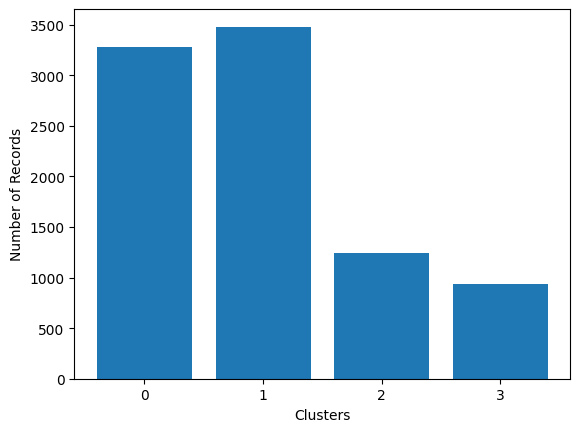

In [26]:
labels = best_model.labels_
indexes, values = np.unique(labels, return_counts=True)
rects = plt.bar(indexes, values)
plt.xlabel('Clusters')
plt.ylabel('Number of Records')
plt.xticks(indexes)
plt.show()

In [27]:
{indexes[i]: values[i] for i in range(len(indexes))}

{np.int32(0): np.int64(3284),
 np.int32(1): np.int64(3481),
 np.int32(2): np.int64(1247),
 np.int32(3): np.int64(938)}

In [33]:
data['labels'] = labels

The largest cluster is 1 with a total of 3481 members, the second largest is cluster 0 (3284), and the smallest are clusters 2 and 3 with 1247 and 938 members, respectively.

In [37]:
data.labels.value_counts()

labels
1    3481
0    3284
2    1247
3     938
Name: count, dtype: int64

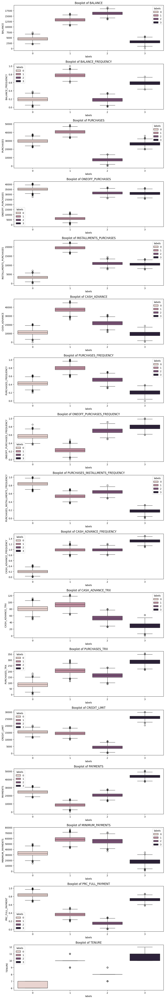

In [43]:
fig, axes = plt.subplots(nrows=len(data.columns)-1, ncols=1, figsize=(10, 60))

for ax, col in zip(axes, data.columns.drop('labels')):

    sns.boxplot(data, x='labels', y=col, hue='labels', ax=ax)
    ax.set_title(f"Boxplot of {col}")

plt.tight_layout()
plt.show()

In [29]:
centroids_array = best_model.cluster_centers_
orig_centroids = robust_scaler.inverse_transform(centroids_array)
centroids = pd.DataFrame(orig_centroids, columns=prepared_data.columns)
centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,4452.026326,0.193595,29752.681785,35149.002826,3313.940095,11126.031098,0.425656,0.567211,0.838359,0.201014,80.929354,85.735079,15523.803872,24626.977335,33335.315794,0.837264,6.363276
1,13249.977641,0.775723,40669.368866,6131.485155,19462.497788,37230.719305,0.797962,0.227420,0.535079,0.990904,92.595519,206.924447,14538.133149,8557.495870,57646.406667,0.363766,9.858949
2,16287.009528,0.180956,7392.854107,31419.508237,10930.971092,21758.726587,0.513903,0.702562,0.642635,0.990374,52.692061,166.350441,4364.170888,20649.268304,54826.651770,0.149811,7.826784
3,3111.774202,0.584411,26343.068443,31049.207165,10487.653120,9340.556535,0.206720,0.797361,0.177931,1.314826,29.754797,284.954158,26125.156427,43725.621891,18429.102172,0.723669,10.598081


#### Findings:

- **Cluster 0 (3284 clients)**: These customers are the newest, their balance and balance_frequency are the second lowest. They love ONEOFF_PURCHASES, and typically not much of INSTALLMENTS_PURCHASES and CASH ADVANCES. They also have the highest percentage of card payment (PRC_FULL_PAYMENT).

- **Cluster 1 (3481 clients)**: Second largest balance and highest balance_frequency. They purchase the most but not much of ONEOFF_PURCHASES. Their INSTALLMENTS_PURCHASES, CASH_ADVANCE, and PURCHASES_FREQUENCY are also the highest of all.

- **Cluster 2 (1247 clients)**: This cluster has the highest average balance of the four, but the lowest balance_frequency, purchases, and credit limit.

- **Cluster 3 (938 clients)**: The lowest balance, cash advance, and purchases_frequency. These customers have been using the card (Tenure) the longest, also have the largest credit_limit, cash_advance_frequancy and payments as well. They also have the second highest PRC_FULL_PAYMENT.